In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Install detectron2

In [2]:
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
import torch, torchvision
torch.__version__

Requirement already up-to-date: torch in /usr/local/lib/python3.7/dist-packages (1.9.0+cu102)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.7/dist-packages (0.10.0+cu102)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-_ghdhl_f
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-_ghdhl_f
     |████████████████████████████████| 645kB 36.7MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5-cp37-none-any.whl size=64497 sha256=1c7a640ad616a5935c04cea6b46b61efe101ef70a45232e82d9f912bb8411d51
  Stored in directory: /tmp/pip-ephem-wheel-cache-ngslzn0a/wheels/48/53/79/3c6485543a4455a0006f5db590ab9957622b6227011941de06
Successfully built fvcore
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


'1.9.0+cu102'

In [3]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 12521, done.
remote: Counting objects: 100% (15/15), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 12521 (delta 5), reused 12 (delta 5), pack-reused 12506
Receiving objects: 100% (12521/12521), 5.23 MiB | 25.51 MiB/s, done.
Resolving deltas: 100% (8962/8962), done.
Obtaining file:///content/detectron2_repo
     |████████████████████████████████| 81kB 11.3MB/s 
     |████████████████████████████████| 153kB 41.8MB/s 
     |████████████████████████████████| 133kB 50.5MB/s 
     |████████████████████████████████| 112kB 49.4MB/s 
     |████████████████████████████████| 727kB 44.6MB/s 
     |████████████████████████████████| 747kB 38.0MB/s 
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-cp37-none-any.whl size=141231 sha256=a03cce7c277b5035b598dbb8a8375db7b4d24d85670f359e16011b3741a08060
  Stored in directory: /root/.cache/pip/wheels/e3/e2/fa/b78480b448b8579ddf393bebd3f47ee23

In [28]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog, build_detection_test_loader

# Train on a custom COCO dataset

In this section, we show how to train an existing detectron2 model on a custom dataset in a new format.

We use [the fruits nuts segmentation dataset](https://github.com/Tony607/mmdetection_instance_segmentation_demo)
which only has 3 classes: data, fig, and hazelnut.
We'll train a segmentation model from an existing model pre-trained on the COCO dataset, available in detectron2's model zoo.

Note that the COCO dataset does not have the "data", "fig" and "hazelnut" categories.

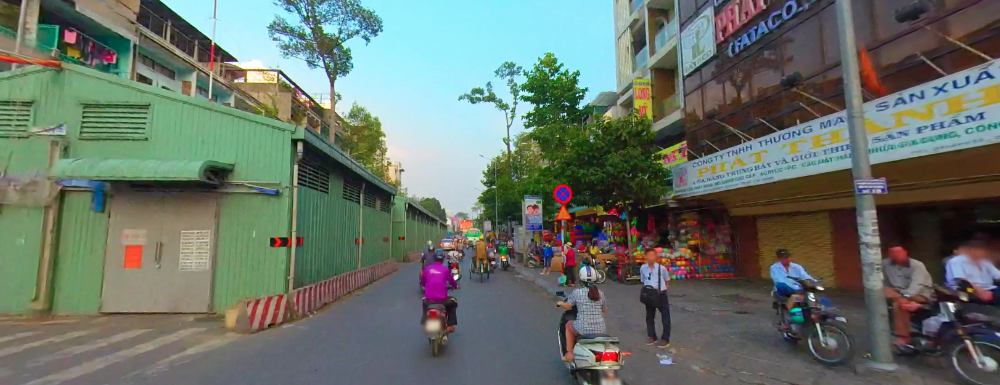

In [7]:
import os
import random

train_images = list(os.listdir("/content/drive/MyDrive/ATI_Final/za_traffic_2020/traffic_train/images"))
rand_img = random.choice(train_images)
rand_img
im = cv2.imread("/content/drive/MyDrive/ATI_Final/za_traffic_2020/traffic_train/images/" + rand_img)
cv2_imshow(im)

In [8]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

model_final_280758.pkl: 167MB [00:25, 6.61MB/s]                           
The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}
/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are relea

In [9]:
# look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([ 0,  0,  0,  0,  0,  0,  3, 26,  3,  0,  0,  3,  3,  0,  2,  3,  2],
       device='cuda:0')
Boxes(tensor([[1033.7107,  404.8293, 1090.1152,  562.1787],
        [ 679.5141,  407.6394,  746.8575,  538.6464],
        [1251.0391,  402.1418, 1334.4902,  535.5584],
        [ 901.7293,  445.5116,  992.8566,  598.9626],
        [1428.8650,  395.5460, 1519.1998,  566.9527],
        [1523.8380,  370.4566, 1621.7203,  497.6931],
        [1252.0117,  457.2610, 1387.7122,  597.5930],
        [1037.0358,  430.0532, 1067.9948,  499.5153],
        [1441.2941,  468.2208, 1621.9999,  616.4755],
        [ 913.1206,  393.1272,  935.6572,  463.4227],
        [ 768.4187,  383.9110,  790.9202,  443.5080],
        [ 810.9929,  411.7935,  826.6494,  440.4212],
        [ 683.2555,  493.4300,  727.1995,  579.3490],
        [ 878.2552,  391.7673,  897.3882,  446.0806],
        [ 713.3188,  386.5954,  736.6425,  405.8042],
        [ 919.1558,  542.4990, 1016.6069,  623.6284],
        [ 704.2227,  404.2508

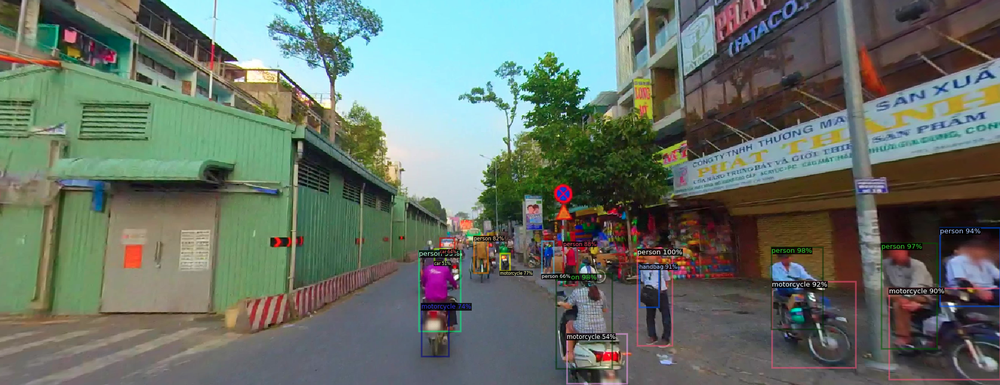

In [10]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("traffic_signs", {}, "/content/drive/MyDrive/ATI_Final/za_traffic_2020/traffic_train/train_traffic_sign_dataset.json", "/content/drive/MyDrive/ATI_Final/za_traffic_2020/traffic_train/images")

In [13]:
traffic_signs_metadata = MetadataCatalog.get("traffic_signs")
dataset_dicts = DatasetCatalog.get("traffic_signs")

[07/08 05:00:27 d2.data.datasets.coco]: Loaded 4500 images in COCO format from /content/drive/MyDrive/ATI_Final/za_traffic_2020/traffic_train/train_traffic_sign_dataset.json


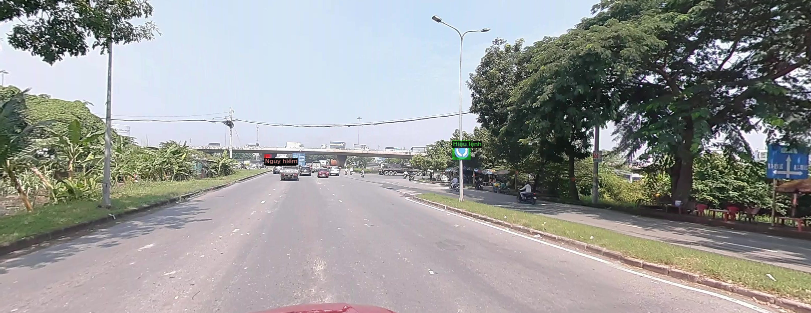

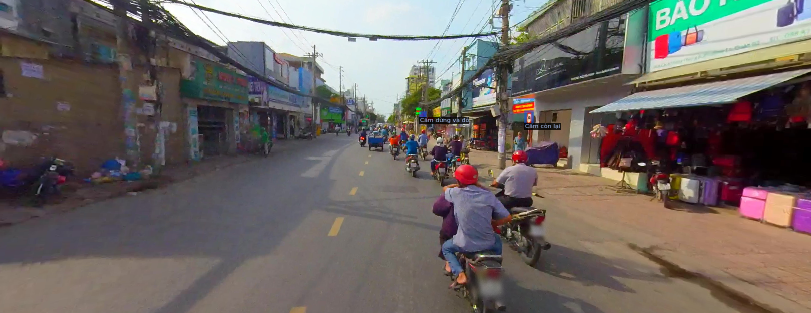

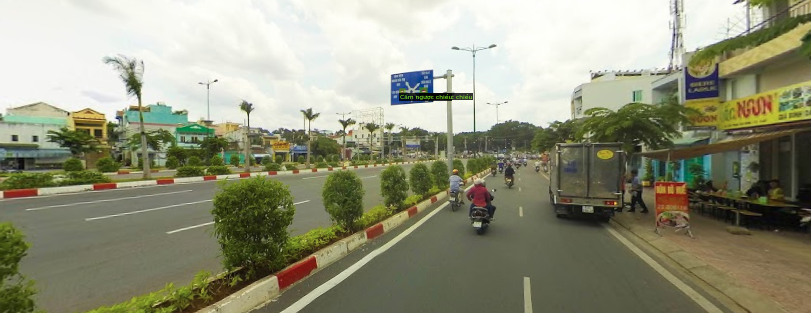

In [14]:

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=traffic_signs_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

Register the fruits_nuts dataset to detectron2, following the [detectron2 custom dataset tutorial](https://detectron2.readthedocs.io/tutorials/datasets.html).


In [15]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("traffic_signs",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 1500    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 7 

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[07/08 05:01:03 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (28, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (28,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, 

[07/08 05:01:05 d2.engine.train_loop]: Starting training from iteration 0
[07/08 05:01:16 d2.utils.events]:  eta: 0:12:22  iter: 19  total_loss: 2.573  loss_cls: 2.174  loss_box_reg: 0.03564  loss_rpn_cls: 0.1052  loss_rpn_loc: 0.1413  time: 0.5150  data_time: 0.1695  lr: 4.9953e-06  max_mem: 2180M
[07/08 05:01:27 d2.utils.events]:  eta: 0:12:34  iter: 39  total_loss: 2.344  loss_cls: 2.075  loss_box_reg: 0.09186  loss_rpn_cls: 0.09075  loss_rpn_loc: 0.08219  time: 0.5445  data_time: 0.2029  lr: 9.9902e-06  max_mem: 2180M
[07/08 05:01:40 d2.utils.events]:  eta: 0:13:11  iter: 59  total_loss: 2.062  loss_cls: 1.764  loss_box_reg: 0.05427  loss_rpn_cls: 0.1022  loss_rpn_loc: 0.1452  time: 0.5704  data_time: 0.2473  lr: 1.4985e-05  max_mem: 2180M
[07/08 05:01:51 d2.utils.events]:  eta: 0:13:10  iter: 79  total_loss: 1.791  loss_cls: 1.408  loss_box_reg: 0.1023  loss_rpn_cls: 0.1078  loss_rpn_loc: 0.1011  time: 0.5729  data_time: 0.2039  lr: 1.998e-05  max_mem: 2180M
[07/08 05:02:02 d2.uti

In [25]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [24]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
cfg.DATASETS.TEST = ("traffic_signs", )
predictor = DefaultPredictor(cfg)

In [29]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

evaluator = COCOEvaluator("traffic_signs", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "traffic_signs")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [07/08 05:24:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[07/08 05:24:36 d2.data.datasets.coco]: Loaded 4500 images in COCO format from /content/drive/MyDrive/ATI_Final/za_traffic_2020/traffic_train/train_traffic_sign_dataset.json
[07/08 05:24:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[07/08 05:24:36 d2.data.common]: Serializing 4500 elements to byte tensors and concatenating them all ...
[07/08 05:24:36 d2.data.common]: Serialized dataset takes 1.38 MiB
[07/08 05:24:36 d2.evaluation.evaluator]: Start inference on 4500 batches
[07/08 05:24:38 d2.evaluation.evaluator]: Inference done 11/4500. Dataloading: 0.0679 s/iter. Inference: 0.0939 s/iter. Eval: 0.0003 s/iter. Total: 0.1621 s/iter. ETA=0:12:07
[07/08 05:24:43 d2.evaluation.evaluator]: Inference don

OrderedDict([('bbox',
              {'AP': 19.7796975592646,
               'AP-Cấm còn lại': 11.106494130702899,
               'AP-Cấm dừng và đỗ': 35.195162871177736,
               'AP-Cấm ngược chiều': 23.033200521646606,
               'AP-Cấm rẽ': 11.308266145141555,
               'AP-Giới hạn tốc độ': 20.786283669233217,
               'AP-Hiệu lệnh': 12.496379704273684,
               'AP-Nguy hiểm': 24.53209587267652,
               'AP50': 38.65835166778089,
               'AP75': 18.07726492509045,
               'APl': 30.445390707846006,
               'APm': 33.65387150487966,
               'APs': 16.833964223881555})])

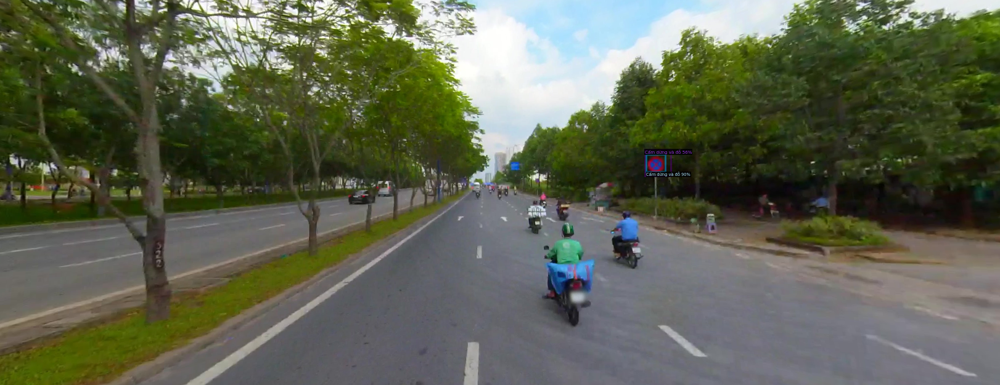

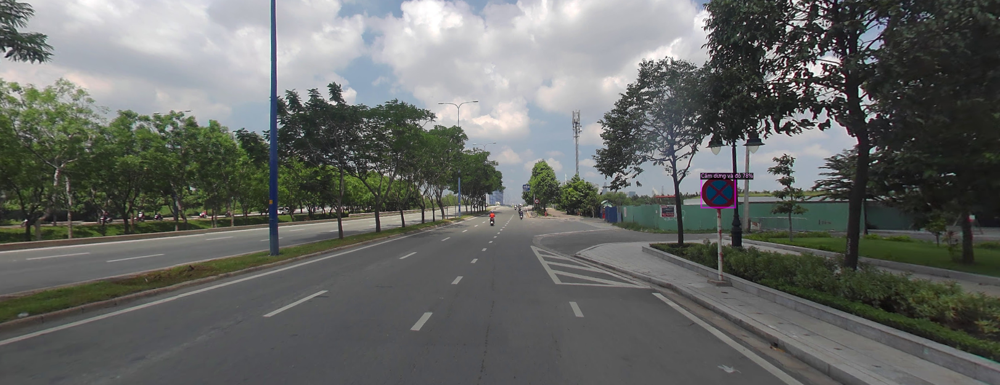

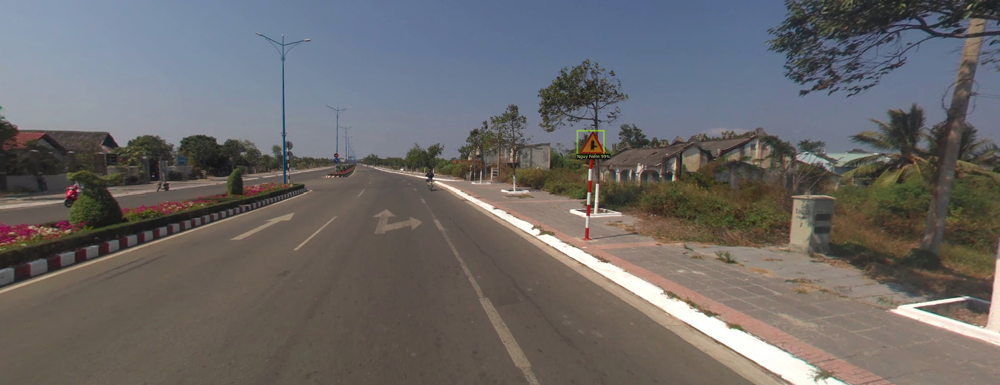

In [23]:
path="/content/drive/MyDrive/ATI_Final/za_traffic_2020/traffic_public_test/images/"
files=os.listdir(path)
for d in random.sample(files, 3):
    im = cv2.imread(path + str(d))
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
      metadata=traffic_signs_metadata,
      scale=1)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])